In [1]:
import os
import cv2
import numpy as np
from tqdm import tqdm
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import albumentations as A
from albumentations.pytorch import ToTensorV2

from resnet50_unet import UNetWithResnet50Encoder
from utils import BinaryLovaszHingeLoss, DiceLoss, JaccardLoss, dice_coefficient, show_images_and_masks
import random

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Fix seed
np.random.seed(42)
torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed(42)
    torch.cuda.manual_seed_all(42)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False




In [7]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2
import os
import numpy as np
from torch.utils.data import Dataset
from PIL import Image

class CustomDataset(Dataset):
    def __init__(self, image_dir, mask_dir, augment=False, denoise=False):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.denoise = denoise
        self.image_files = [f for f in os.listdir(image_dir) if f.endswith('.png')]
        self.augment = augment

        self.augment_transform = A.Compose([
            A.OneOf([
                A.Rotate(limit=180, p=0.5),
                A.ElasticTransform(alpha=5, sigma=20, alpha_affine=30, p=0.5),
                #A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.2, rotate_limit=45, p=0.5),
            ], p=1.0),
            A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.5),
            A.GaussianBlur(blur_limit=3, p=0.5),
            A.GaussNoise(var_limit=(10, 50), p=0.5),
            A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.5),
            A.RandomResizedCrop(height=512, width=512, scale=(0.8, 1.0), ratio=(0.75, 1.33), p=0.5),
            A.CLAHE(clip_limit=4.0, tile_grid_size=(30,30), p=1),
            #A.CoarseDropout(max_holes=16, max_height=30, max_width=30, min_holes=8, min_height=10, min_width=10, fill_value=0, p=0.5),
            A.ToFloat(max_value=255.0),
            ToTensorV2(),
        ])


        self.basic_transform = A.Compose([
            A.CLAHE(clip_limit=4.0, tile_grid_size=(30,30), p=1),
            A.ToFloat(max_value=255.0),
            ToTensorV2(),
        ])

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_filename = self.image_files[idx]
        image_path = os.path.join(self.image_dir, image_filename)
        mask_path = os.path.join(self.mask_dir, image_filename.replace('image', 'mask'))

        image = cv2.imread(image_path, cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        
        image = 255 - image
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

        if self.denoise:
            image = cv2.fastNlMeansDenoising(image, None, h=15, templateWindowSize=7, searchWindowSize=21)

        image_pil = Image.fromarray(image).convert('RGB')  
        mask_pil = Image.fromarray(mask)

        image_pil = image_pil.resize((512, 512), Image.LANCZOS)
        mask_pil = mask_pil.resize((512, 512), Image.LANCZOS)

        image = np.array(image_pil)
        mask = np.array(mask_pil)
        _, mask = cv2.threshold(mask, 127, 1, cv2.THRESH_BINARY)


        if self.augment:
            augmented = self.augment_transform(image=image, mask=mask)
        else:
            augmented = self.basic_transform(image=image, mask=mask)

        image = augmented['image']
        mask = augmented['mask']

        return image, mask.float()


In [3]:
def freeze_all_encoder_layers(model):
    for layer in model.down_blocks:
        for param in layer.parameters():
            param.requires_grad = False


In [4]:
def unfreeze_model(model):
    for param in model.parameters():
        param.requires_grad = True

In [5]:
def unfreeze_block(model, block_name):
    """
    Unfreezes a specific block of the ResNet encoder within the U-Net model.

    Parameters:
    - model: The instance of your UNetWithResnet50Encoder model.
    - block_name: A string name of the block to unfreeze (e.g., 'layer4', 'layer3').
    """
    if hasattr(model, 'down_blocks'):
        for block in model.down_blocks:
            # The down_blocks attribute is a ModuleList; each block is a layer in ResNet
            if block_name == block.__class__.__name__:
                for param in block.parameters():
                    param.requires_grad = True
    else:
        print(f"The model does not have the specified block: {block_name}")


In [3]:
# Data Loaders
num_epochs = 50
BATCH_SIZE = 1
name_model = 'best_model_pretrain_invert_DRIVE'
train_dataset = CustomDataset('../DRIVE_dataset/train/images' , '../DRIVE_dataset/train/masks', augment=True, denoise=False)
val_dataset = CustomDataset('../DRIVE_dataset/test/images', '../DRIVE_dataset/test/masks', augment=False, denoise=False)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Model, Optimizer, and Loss Functions
model = UNetWithResnet50Encoder(n_classes=1).to(device)
model.load_state_dict(torch.load('output_pretrain/best_model_pretrain_invert_DRIVE.pth'))
#freeze_all_encoder_layers(model)
#unfreeze_model(model)

C:\Users\alois\AppData\Roaming\Python\Python311\site-packages\albumentations\augmentations\blur\transforms.py:189: UserWarning: blur_limit and sigma_limit minimum value can not be both equal to 0. blur_limit minimum value changed to 3.
  warnings.warn(


<All keys matched successfully>

In [7]:
import torchsummary
#torchsummary.summary(model, (3, 512, 512))

In [8]:
def create_optimizer_param_groups(model):
    encoder_params = []
    decoder_params = []
    
    for block in model.down_blocks:
        for param in block.parameters():
            if param.requires_grad:
                encoder_params.append(param)
                

    for block in model.up_blocks:
        for param in block.parameters():
            if param.requires_grad:
                decoder_params.append(param)

    param_groups = [
        {'params': encoder_params, 'lr': 1e-3},  
        {'params': decoder_params, 'lr': 1e-2}   
    ]
    
    return param_groups

#optimizer = torch.optim.AdamW(create_optimizer_param_groups(model))


In [9]:
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3, weight_decay=0.0001)
#optimizer = torch.optim.SGD(model.parameters(), lr=1e-3, weight_decay=0.0001)
#optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=0.001, weight_decay=0.0001)
#scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2, verbose=True)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
loss_fn = DiceLoss().to(device)

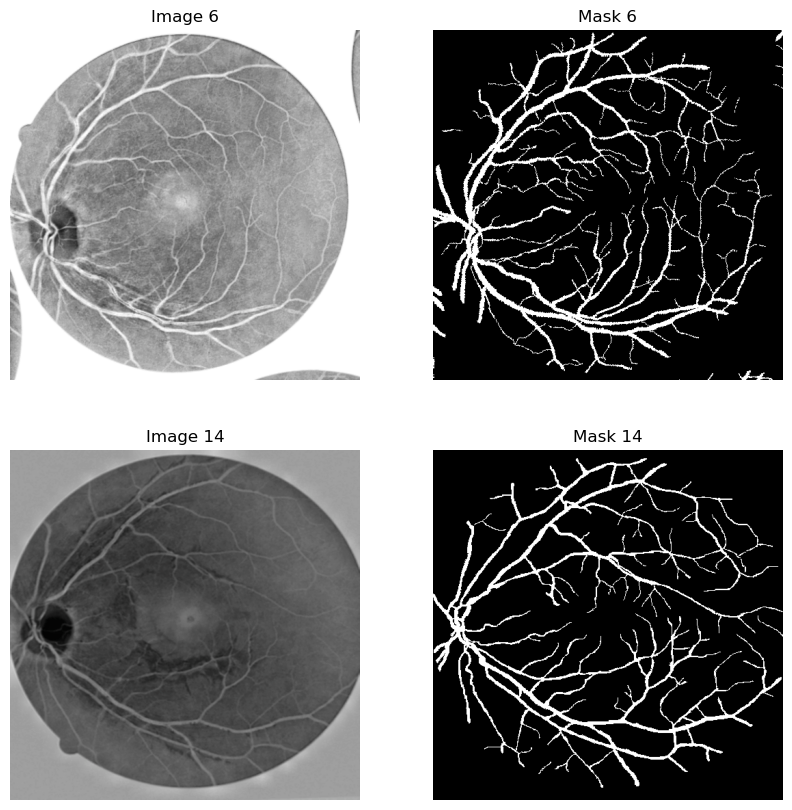

In [10]:
# Display train set
show_images_and_masks(train_dataset, num_imgs=2)

In [11]:
# Training Function
def train_one_epoch(epoch):
    model.train()
    loss_total = 0.0
    loss_throughout_epoch = []

    for input_img, mask in tqdm(train_loader, desc=f'Training epoch {epoch}'):
        input_img, mask = input_img.to(device), mask.to(device)

        optimizer.zero_grad()
        output = model(input_img)
        loss = loss_fn(output, mask)

        # Combine losses and backpropagate, normalize them against each other
        loss.backward()
        optimizer.step()

        # Accumulate individual losses for logging
        loss_total += loss.item()
        loss_throughout_epoch.append(loss.item())
    
    # Save graph of loss throughout epoch
    plt.figure(figsize=(12, 8))
    plt.plot(loss_throughout_epoch, label='Loss')
    plt.title('Loss')
    plt.legend()
    plt.tight_layout()
    if not os.path.exists('output_pretrain'):
        os.makedirs('output_pretrain')

    plt.savefig(f'output_pretrain/internalloss_graph_epoch_{epoch}.png')
    plt.close()

    return loss_total / len(train_loader)

# Validation Function
def validate(epoch):
    model.eval()
    loss_total = 0.0

    with torch.no_grad():
        for input_img, mask in tqdm(val_loader, desc=f'Validating epoch {epoch}'):
            input_img, mask = input_img.to(device), mask.to(device)

            output = model(input_img)
            loss = loss_fn(output, mask)
            loss_total += loss.item()

    return loss_total / len(val_loader)


# Plot Loss Function
def plot_loss(epoch,train_inp_losses, val_inp_losses):
    plt.figure(figsize=(12, 8))

    epochs = range(1, epoch + 2)  

    plt.plot(epochs, train_inp_losses, label='Train Loss')
    plt.plot(epochs, val_inp_losses, label='Val Loss')
    plt.title('Loss')
    plt.legend()

    plt.tight_layout()
    plt.savefig(f'output_pretrain/loss_graph.png')
    plt.close()


# Save Model Function
def save_model(model, path):
    torch.save(model.state_dict(), path)


train_inp_losses = []
val_inp_losses = []

best_val_loss = float('inf')  # Initialize with a high value
best_model_path = ''  # Path to save the best model


 
for epoch in range(num_epochs):
    train_inp_loss = train_one_epoch(epoch) 
    scheduler.step(train_inp_loss)
    val_inp_loss = validate(epoch)  
    train_inp_losses.append(train_inp_loss)  
    val_inp_losses.append(val_inp_loss)  

    # Save model if it has the lowest validation loss so far
    if val_inp_loss < best_val_loss:
        best_val_loss = val_inp_loss
        best_model_path = f'output_pretrain/{name_model}.pth'
        save_model(model, best_model_path)  

    print(f'Epoch {epoch}, Train Loss: {train_inp_loss}, Val Loss: {val_inp_loss}')

    # Save model for every epoch (optional if you only want the best model)
    #save_model(model, f'output_pretrain/model_epoch_{epoch}.pth')

    plot_loss(epoch, train_inp_losses, val_inp_losses)

Training epoch 0: 100%|██████████| 17/17 [00:30<00:00,  1.81s/it]
c:\Users\alois\anaconda3\Lib\site-packages\torch\optim\lr_scheduler.py:156: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)
Validating epoch 0: 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]


Epoch 0, Train Loss: 0.6748641273554634, Val Loss: 0.7583051125208536


Validating epoch 1: 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]


Epoch 1, Train Loss: 0.5889066668117747, Val Loss: 0.5942479570706686


Validating epoch 2: 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]


Epoch 2, Train Loss: 0.5316997731433195, Val Loss: 0.5723867813746134


Validating epoch 3: 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]


Epoch 3, Train Loss: 0.48766670507543225, Val Loss: 0.4607149362564087


Validating epoch 4: 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]


Epoch 4, Train Loss: 0.4270631145028507, Val Loss: 0.46762744585673016


Validating epoch 5: 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]


Epoch 5, Train Loss: 0.3752666396253249, Val Loss: 0.404715895652771


Validating epoch 6: 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]


Epoch 6, Train Loss: 0.3613657144939198, Val Loss: 0.31945423285166424


Validating epoch 7: 100%|██████████| 3/3 [00:01<00:00,  2.95it/s]


Epoch 7, Train Loss: 0.3254049876156975, Val Loss: 0.3283369739850362


Validating epoch 8: 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]


Epoch 8, Train Loss: 0.30828459122601676, Val Loss: 0.29697728157043457


Validating epoch 9: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s]


Epoch 9, Train Loss: 0.29154492125791664, Val Loss: 0.4529651999473572


Validating epoch 10: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s]


Epoch 10, Train Loss: 0.29045284846249747, Val Loss: 0.30620797475179035


Validating epoch 11: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]


Epoch 11, Train Loss: 0.2943681969362147, Val Loss: 0.27934207518895465


Validating epoch 12: 100%|██████████| 3/3 [00:01<00:00,  2.87it/s]


Epoch 12, Train Loss: 0.2811729802804835, Val Loss: 0.3283475637435913


Validating epoch 13: 100%|██████████| 3/3 [00:01<00:00,  2.86it/s]


Epoch 13, Train Loss: 0.2776047938010272, Val Loss: 0.30319905281066895


Validating epoch 14: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s]


Epoch 14, Train Loss: 0.2675374886568855, Val Loss: 0.7302118142445883


Validating epoch 15: 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]


Epoch 15, Train Loss: 0.278122134068433, Val Loss: 0.23081562916437784


Validating epoch 16: 100%|██████████| 3/3 [00:01<00:00,  2.95it/s]


Epoch 16, Train Loss: 0.268201842027552, Val Loss: 0.27686721086502075


Validating epoch 17: 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]


Epoch 17, Train Loss: 0.267977072912104, Val Loss: 0.24464197953542074


Validating epoch 18: 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]


Epoch 18, Train Loss: 0.2779982125057894, Val Loss: 0.23226712147394815


Validating epoch 19: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]


Epoch 19, Train Loss: 0.26789157530840707, Val Loss: 0.24783804019292197


Validating epoch 20: 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]


Epoch 20, Train Loss: 0.2715136724359849, Val Loss: 0.660081148147583


Validating epoch 21: 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]


Epoch 21, Train Loss: 0.272565575206981, Val Loss: 0.2387708822886149


Validating epoch 22: 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]


Epoch 22, Train Loss: 0.2614865267977995, Val Loss: 0.2588350574175517


Validating epoch 23: 100%|██████████| 3/3 [00:01<00:00,  2.86it/s]


Epoch 23, Train Loss: 0.25282686948776245, Val Loss: 0.20618913571039835


Validating epoch 24: 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]


Epoch 24, Train Loss: 0.2547787217532887, Val Loss: 0.21608251333236694


Validating epoch 25: 100%|██████████| 3/3 [00:01<00:00,  2.95it/s]


Epoch 25, Train Loss: 0.25284180571051207, Val Loss: 0.2419926921526591


Validating epoch 26: 100%|██████████| 3/3 [00:01<00:00,  2.95it/s]


Epoch 26, Train Loss: 0.25939613580703735, Val Loss: 0.32148832082748413


Validating epoch 27: 100%|██████████| 3/3 [00:01<00:00,  2.95it/s]


Epoch 27, Train Loss: 0.2488431965603548, Val Loss: 0.7186627189318339


Validating epoch 28: 100%|██████████| 3/3 [00:01<00:00,  2.93it/s]


Epoch 28, Train Loss: 0.2624480969765607, Val Loss: 0.21897685527801514


Validating epoch 29: 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]


Epoch 29, Train Loss: 0.2433669216492597, Val Loss: 0.21284107367197672


Validating epoch 30: 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]


Epoch 30, Train Loss: 0.25087988026001873, Val Loss: 0.19459466139475504


Validating epoch 31: 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]


Epoch 31, Train Loss: 0.2536022943608901, Val Loss: 0.20986972252527872


Validating epoch 32: 100%|██████████| 3/3 [00:01<00:00,  2.56it/s]


Epoch 32, Train Loss: 0.24999577858868768, Val Loss: 0.205418328444163


Validating epoch 33: 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]


Epoch 33, Train Loss: 0.24989145643570843, Val Loss: 0.21019607782363892


Validating epoch 34: 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]


Epoch 34, Train Loss: 0.2567938355838551, Val Loss: 0.21523680289586386


Validating epoch 35: 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]


Epoch 35, Train Loss: 0.24354025546242208, Val Loss: 0.21576762199401855


Training epoch 36:   0%|          | 0/17 [00:02<?, ?it/s]


KeyboardInterrupt: 

# Prediction

In [4]:
import matplotlib.pyplot as plt

def visualize(image, true_mask=None, predicted_mask=None):
    """Visualize comparison between input image, true mask, and predicted mask."""
    fig, axs = plt.subplots(1, 3, figsize=(20, 10)) 

    axs[0].imshow(image, cmap='gray')
    axs[0].set_title('Input Image')
    axs[0].axis('off')

    if true_mask is not None:
        axs[1].imshow(true_mask, cmap='gray')
        axs[1].set_title('True Mask')
        axs[1].axis('off')
    else:
        axs[1].axis('off')

    axs[2].imshow(predicted_mask, cmap='gray')
    axs[2].set_title('Predicted Mask')
    axs[2].axis('off')

    plt.show()


In [5]:
def predict_and_visualize(model, dataset, device, n_images):
    model.eval()
    dice_scores = []
    with torch.no_grad():
        for i in range(n_images):
            input_img, true_mask = dataset[i]
            input_img_unsqueeze = input_img.unsqueeze(0).to(device)

            # Predict
            pred_mask_logits = model(input_img_unsqueeze)
            pred_mask_prob = torch.sigmoid(pred_mask_logits)
            pred_mask = pred_mask_prob > 0.5 

            # Calculate Dice Coefficient
            pred = pred_mask.squeeze()
            dice_score = dice_coefficient(pred, true_mask.to(device), smooth=1e-6)

            dice_scores.append(dice_score.item())

            # Convert for visualization
            pred_mask_np = pred_mask.squeeze().cpu().numpy() 
            input_img_np = input_img.squeeze().permute(1, 2, 0).cpu().numpy()
            input_img_np = (input_img_np * 255).astype(np.uint8)
            true_mask_np = true_mask.squeeze().cpu().numpy() if true_mask is not None else None 

            visualize(
                image=input_img_np, 
                true_mask=true_mask_np,
                predicted_mask=pred_mask_np
            )

    # Print the average Dice score at the end 
    average_dice_score = np.mean(dice_scores) 
    print(f'Average Dice Coefficient over {n_images} images: {average_dice_score:.4f}')


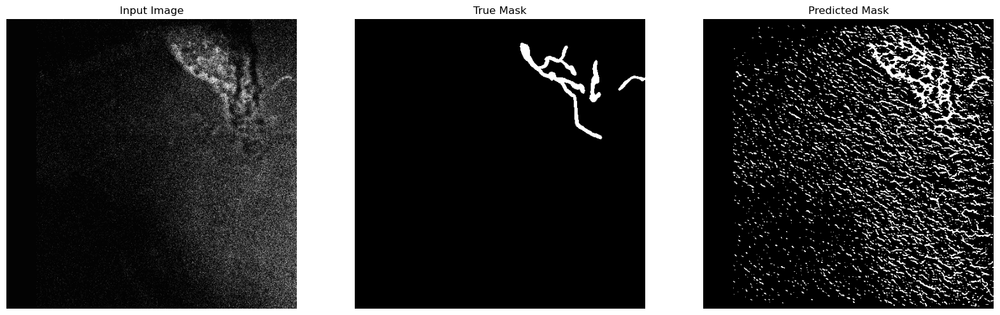

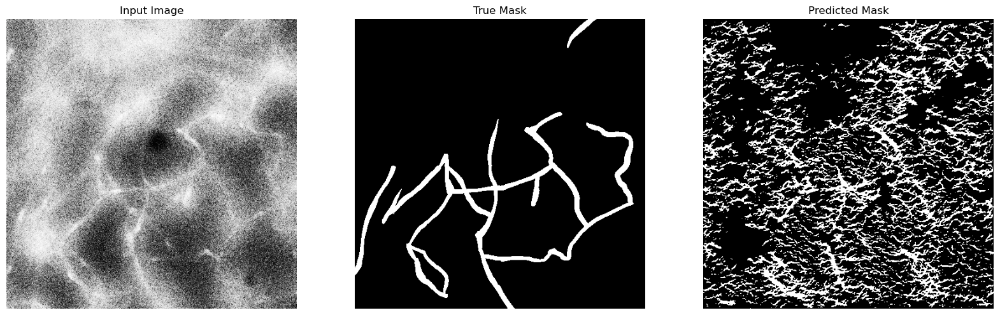

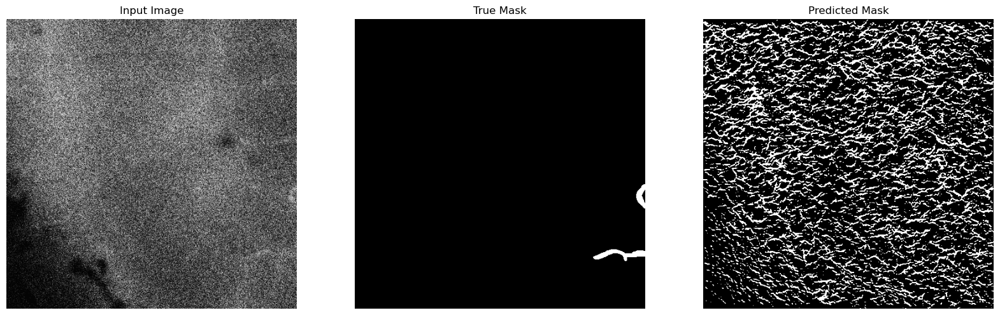

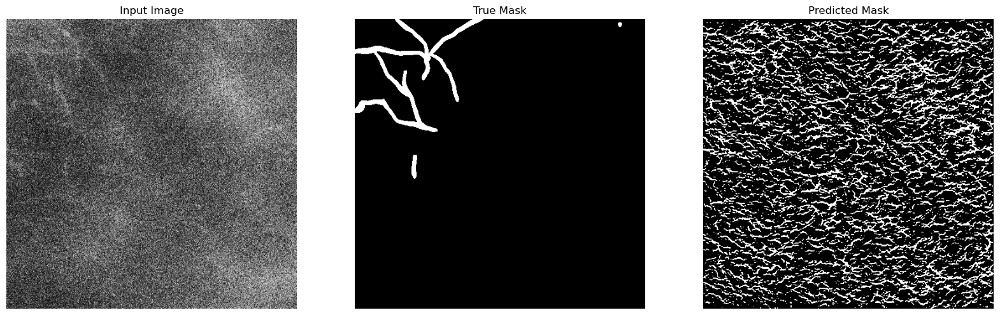

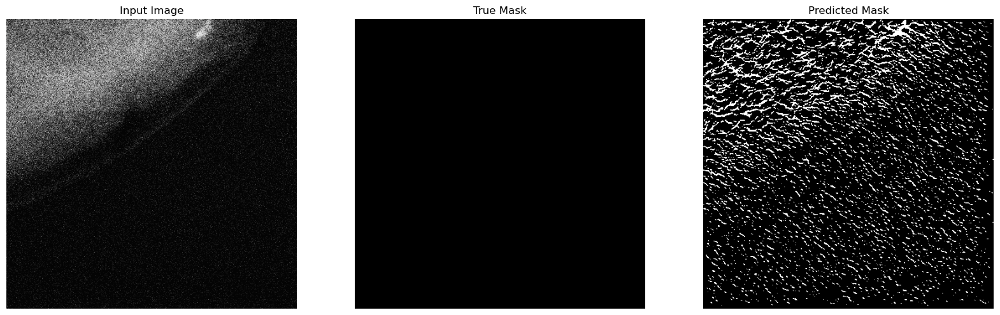

...

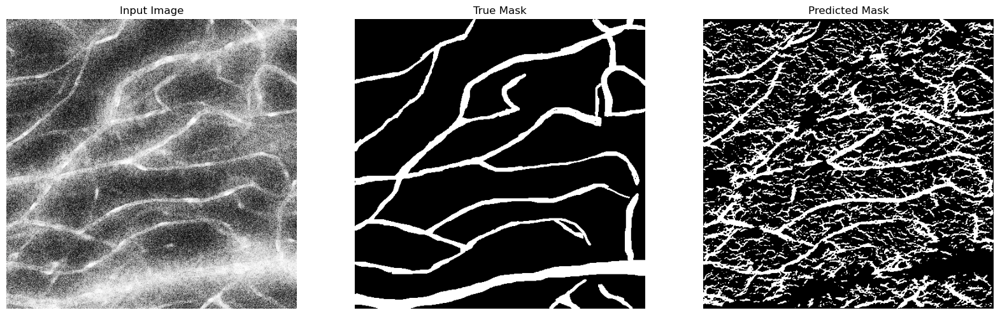

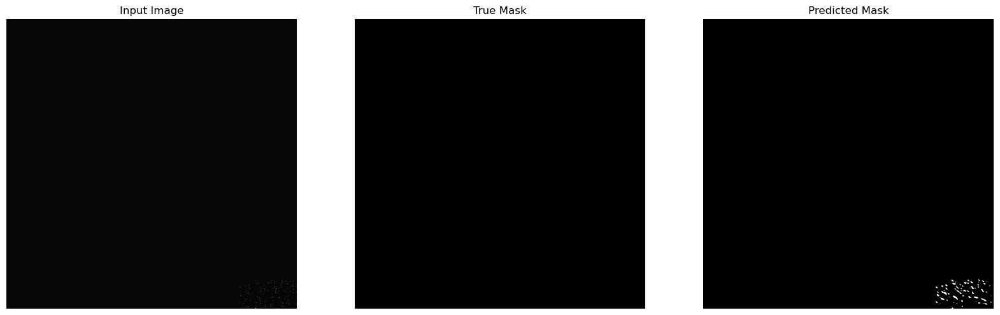

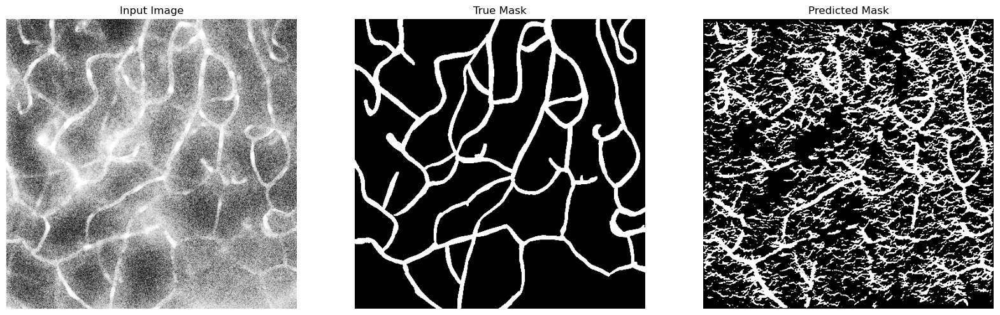

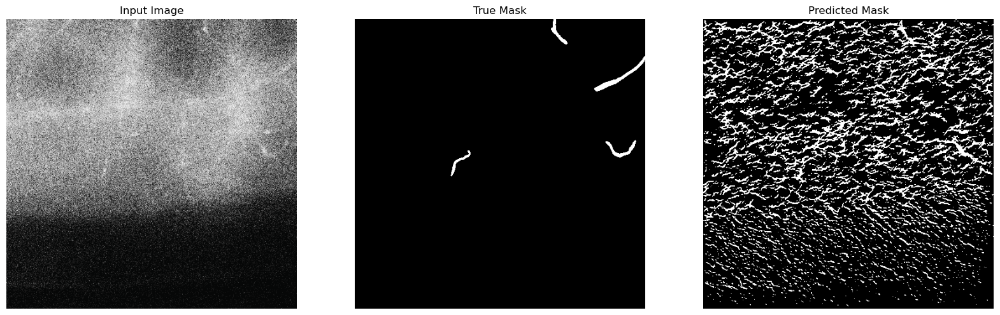

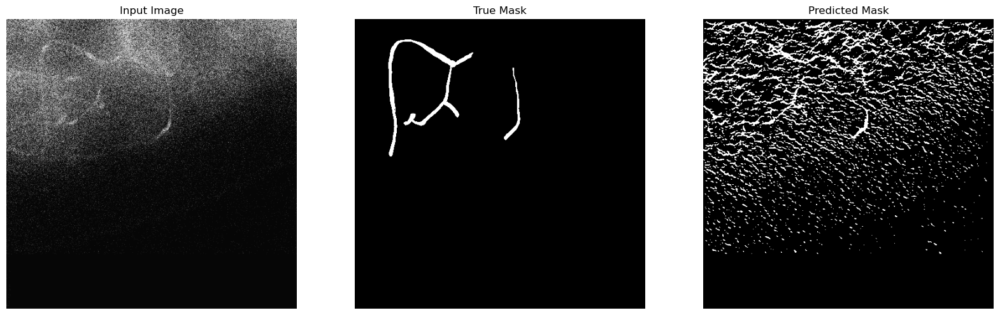

Average Dice Coefficient over 29 images: 0.1467


In [9]:
test_dataset = CustomDataset('../data_model_small/test/images', '../data_model_small/test/masks', augment=False, denoise=False)

# Load the model (ensure the model is already trained and weights are loaded)
model = UNetWithResnet50Encoder(n_classes=1).to(device)
model.load_state_dict(torch.load(f'output_pretrain/{name_model}.pth'))
# Predict and visualize on the real data
predict_and_visualize(model, test_dataset, device, n_images=len(test_dataset))
